In [563]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
import cv2
import tarfile
import os

In [604]:
# Have a look at one almost empty carlot image
# --------------------------------
# path for PUCPR
img_path = '../data/PKLot/PKLot/PUCPR/Cloudy/2012-10-14/'   

#image = '2012-09-16_18_13_23'     # image without cars
image = '2012-10-14_05_54_35'
#image = '2012-09-16_08_33_00'

# Path for UFP04
#img_path = '../data/PKLot/PKLot/UFPR04/Sunny/2013-01-18/'  

#image = '2013-01-18_16_30_12'

# --------------------------------

imge = image+'.jpg'
imge_xml = image+'.xml'

In [605]:
def show_image(image, title = 'Title'):
    plt.figure(figsize=(20,15))
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

In [606]:
# Function to print groundtruth on a image
def print_ground_truth(path = img_path, ground_truth = imge_xml, image = imge):

    # Read the image with opencv
    imgocv = cv2.imread(path+str(image))

    # Specify the path to ground truth .xml
    xml_file_path = path+ground_truth

    # Parse the XML file
    tree = ET.parse(xml_file_path)
    root = tree.getroot()

    bounding_boxes = []

    # Iterate over each space in the parking lot
    for space_element in root.findall('.//space'):
        space_id = space_element.get('id')
        occupied = space_element.get('occupied')
        center = space_element.find('.//rotatedRect/center')
        center_x = int(float(center.get('x')))
        center_y = int(float(center.get('y')))

        # Attempt to find the <contour> element directly under <space>
        contour_element = space_element.find('.//contour')
        
        if contour_element is not None:
            # Attempt to find <point> elements under <contour>
            contour_points = contour_element.findall('point')

            # Convert the list of points to a numpy array
            points_array = np.array([(int(point.get('x')), int(point.get('y'))) for point in contour_points], dtype=np.int32)

            # Check if enough points are available
            if len(points_array) >= 3:
                # Calculate the bounding box coordinates
                rect = cv2.minAreaRect(points_array)
                box = cv2.boxPoints(rect)
                box = box.astype(int)

                bounding_boxes.append(box)

                # Draw the bounding box on the copied image
                cv2.drawContours(imgocv, [box], 0, (0, 255, 0), 2)
            else:
                print("Error: Not enough points for bounding box.")
        else:
            print("Error: <contour> element not found for the space.")

    return imgocv, bounding_boxes

Image shape: (720, 1280, 3)
Image data type: uint8


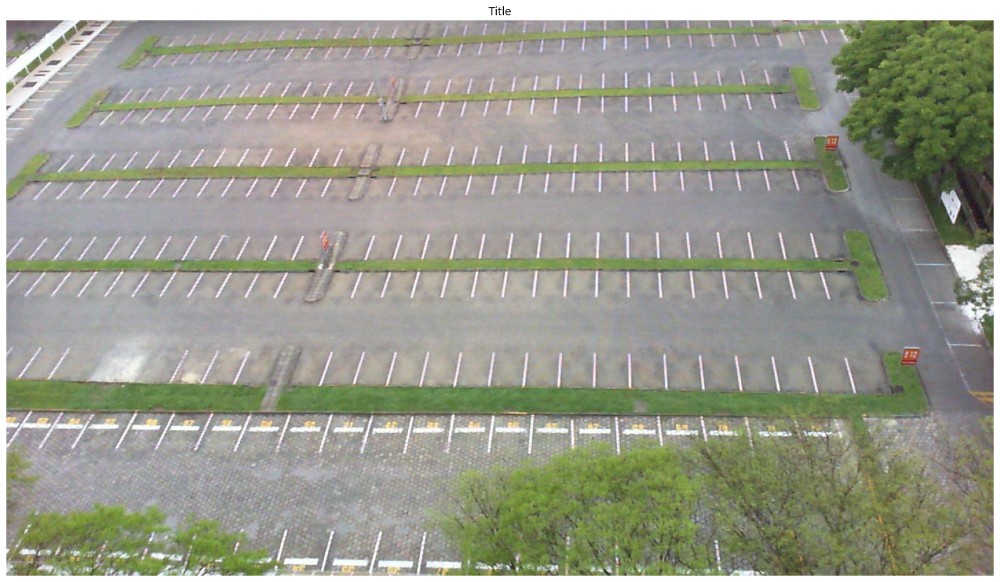

In [607]:
# Read the image
imgocv = cv2.imread(img_path+imge)

# Display information about the image
print(f"Image shape: {imgocv.shape}")
print(f"Image data type: {imgocv.dtype}")

# Convert the image from BGR to RGB (OpenCV uses BGR by default)
img_rgb = cv2.cvtColor(imgocv, cv2.COLOR_BGR2RGB)

# Display the image
show_image(img_rgb)

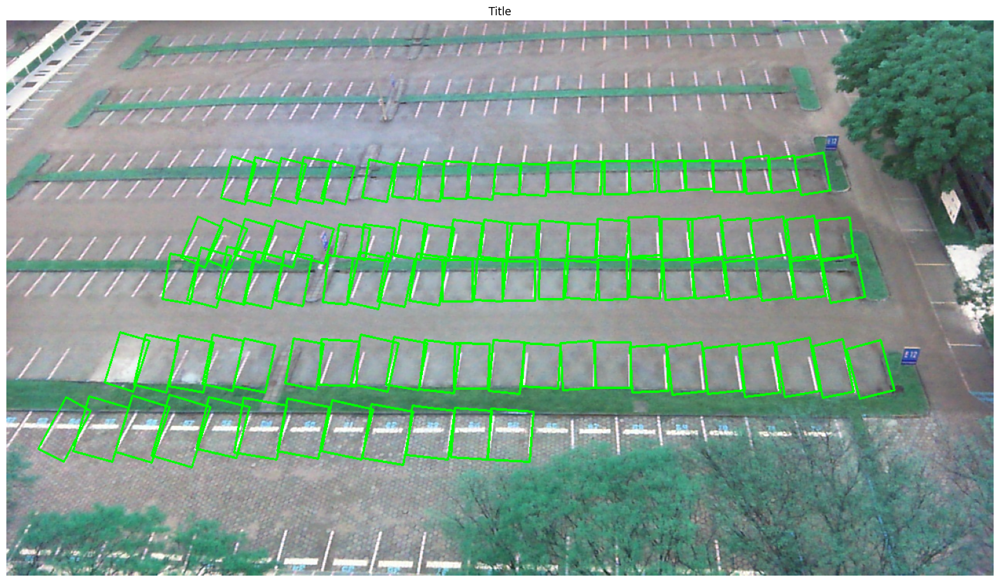

In [608]:
show_image(print_ground_truth()[0])

In [609]:
# extarct bounding boxes
bboxes = print_ground_truth()[1]

bboxes[1] # second bbox use 'cv2.drawContours(imgocv, [box], 0, (0, 255, 0), 2)' to draw on the image

array([[309, 232],
       [322, 177],
       [354, 185],
       [342, 240]])

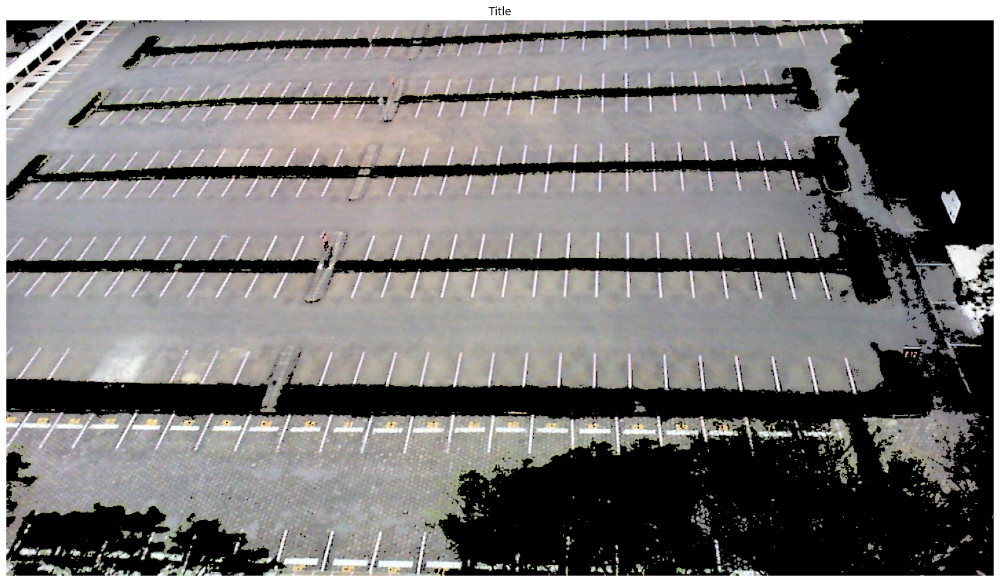

In [610]:
# image is expected be in RGB color space# image 
def select_rgb_white_yellow(image): 
    # white color mask
    lower = np.uint8([120, 120, 120])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(image, lower, upper)
    # yellow color mask
    lower = np.uint8([190, 190,   0])
    upper = np.uint8([255, 255, 255])
    yellow_mask = cv2.inRange(image, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    masked = cv2.bitwise_and(image, image, mask = mask)
    return masked

#white_yellow_images = list(map(select_rgb_white_yellow, test_images))
white_yellow_image = select_rgb_white_yellow(img_rgb)

# display the image
show_image(white_yellow_image)

In [611]:
def edge_detection(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply GaussianBlur to reduce noise and improve edge detection
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Apply Canny edge detector
    edges = cv2.Canny(blurred, 50, 150)
    
    # Return the edges
    return edges

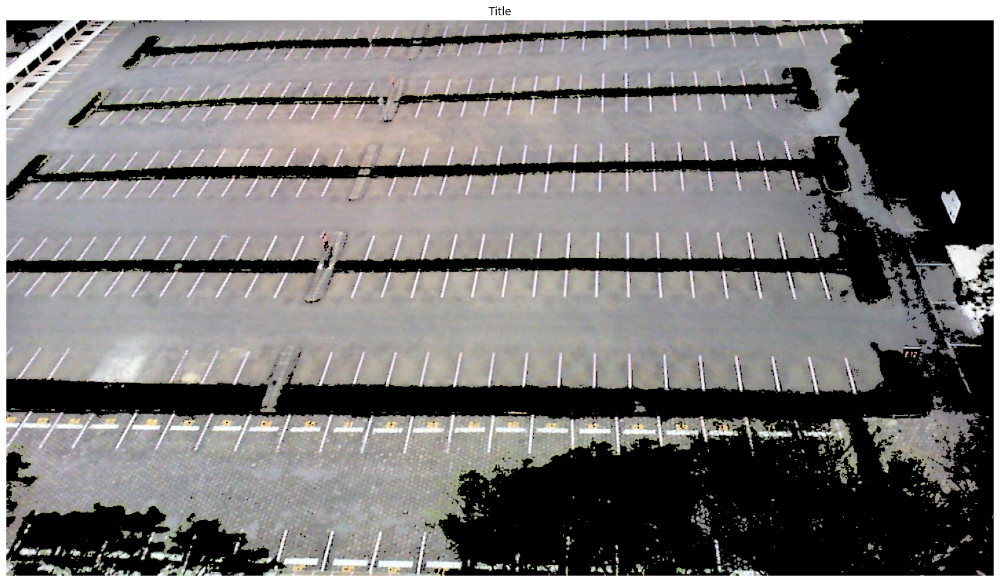

In [612]:
def select_rgb_white_yellow_with_edges(image):
    # Color filtering for white and yellow
    white_yellow_mask = select_rgb_white_yellow(image)
    
    # Edge detection on the color-filtered image
    edges = edge_detection(white_yellow_mask)
    
    # Create a blank image with the same dimensions as the original
    overlay = np.zeros_like(image)
    
    # Set the edges in the overlay to a specific color (e.g., red)
    overlay[edges != 0] = [0, 0, 255]
    
    # Combine the original image with the colored edges
    result = cv2.addWeighted(image, 1, overlay, 0.5, 0)
    
    return result


white_yellow_image_edge = select_rgb_white_yellow(img_rgb)

# display the image
show_image(white_yellow_image_edge)

In [613]:
# Draw the bounding box on the image
#cv2.drawContours(white_yellow_image_edge, [bboxes[9]], 0, (0, 255, 0), 2)
#show_image(white_yellow_image_edge)


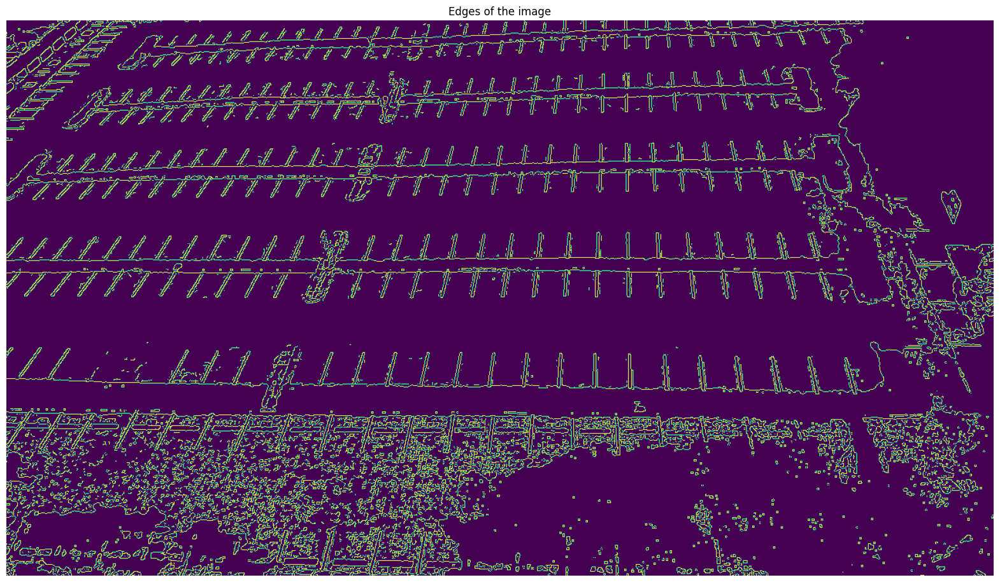

In [614]:
def detect_edges(image, low_threshold=75, high_threshold=100):    # => PARA : 
    return cv2.Canny(image, low_threshold, high_threshold)

edge_image = detect_edges(white_yellow_image_edge)

show_image(edge_image, title='Edges of the image')

In [615]:
def hough_lines(image):
    """
    `image` should be the output of a Canny transform or AdaptiveThreshold.
    
    Returns hough lines (not the image with lines)
    """
    return cv2.HoughLinesP(image, rho=0.1, theta=np.pi/180, threshold=5, minLineLength=1, maxLineGap=1)   # => PARA

list_of_lines = hough_lines(edge_image)

Number of lines detected:  24071


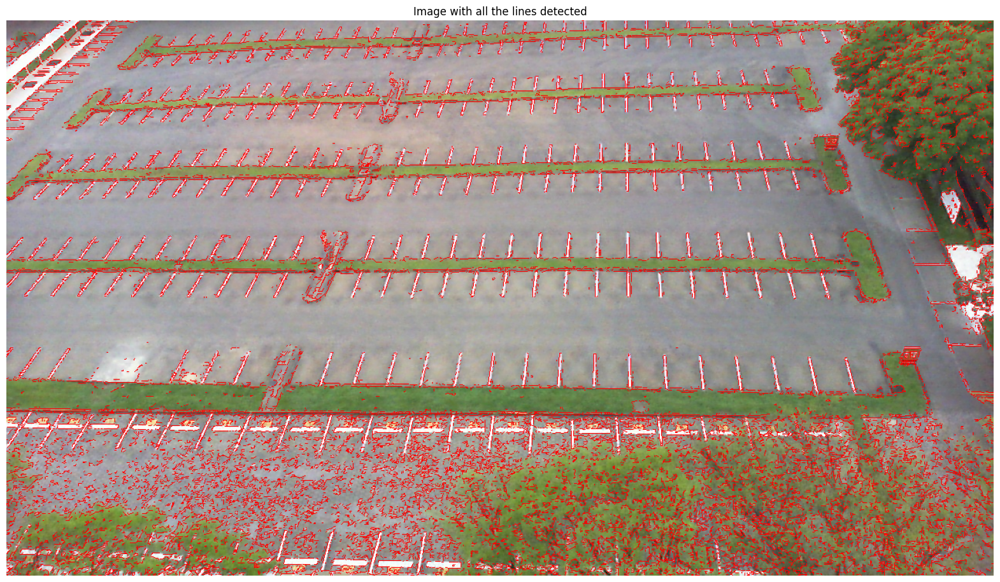

In [616]:
def draw_lines(image, lines, color=[255, 0, 0], thickness=1, make_copy=True):
    if make_copy:
        image = np.copy(image)  # don't want to modify the original
    cleaned = []
    for line in lines:
        for x1, y1, x2, y2 in line: 
            cleaned.append((x1,y1,x2,y2)) 
            cv2.line(image, (x1, y1), (x2, y2), color, thickness)
    print("Number of lines detected: ", len(cleaned))
    return image

# --------------------------------

line_images = []

# Assuming you have a list_of_lines containing lines for img_rgb
lines_for_img_rgb = hough_lines(detect_edges(img_rgb))  # You may need to adjust this based on your actual pipeline

line_images.append(draw_lines(img_rgb, lines_for_img_rgb))
    
show_image(line_images[0], title='Image with all the lines detected')

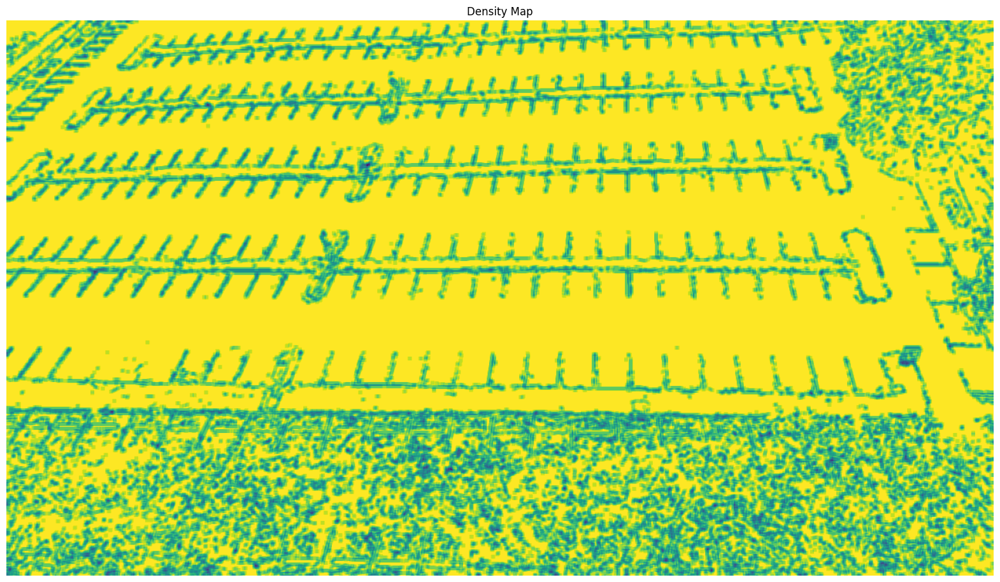

In [617]:
def detect_low_density(image, lines, threshold=0.1):
    # Create a black image as a mask
    mask = np.zeros_like(image[:, :, 0])

    # Draw lines on the mask
    for line in lines:
        for x1, y1, x2, y2 in line:
            cv2.line(mask, (x1, y1), (x2, y2), 1, 1)

    # Invert the mask
    mask = 1 - mask

    # Compute density map
    density_map = cv2.filter2D(mask, -1, np.ones((5, 5), np.uint8))     #  => PARA adjust here

    # Threshold the density map
    _, thresholded = cv2.threshold(density_map, threshold * density_map.max(), 1, cv2.THRESH_BINARY)

    # Optionally, perform image segmentation
    #_, labels, stats, centroids = cv2.connectedComponentsWithStats(thresholded.astype(np.uint8))

    # Display the results
    show_image(density_map / density_map.max(), title="Density Map")
    #show_image( thresholded * 255, title="Thresholded",)

    return thresholded


# Detect low-density areas
low_density_mask = detect_low_density(img_rgb, lines_for_img_rgb, threshold=0.1)


In [618]:
def non_max_suppression(boxes, overlapThresh):
    if len(boxes) == 0:
        return []

    # Convert boxes to a NumPy array
    boxes = np.array(boxes)

    # Initialize list of picked indices
    pick = []

    # Grab the coordinates of the bounding boxes
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    # Compute the area of the bounding boxes
    area = (x2 - x1 + 1) * (y2 - y1 + 1)

    # Sort the bounding boxes by their bottom-right y-coordinate
    idxs = np.argsort(y2)

    while len(idxs) > 0:
        # Grab the last index in the sorted indices list and add the index value to the list of picked indices
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)

        # Find the largest (x, y) coordinates for the start of the bounding box and the smallest (x, y) coordinates for the end of the bounding box
        xx1 = np.maximum(x1[i], x1[idxs[:last]])
        yy1 = np.maximum(y1[i], y1[idxs[:last]])
        xx2 = np.minimum(x2[i], x2[idxs[:last]])
        yy2 = np.minimum(y2[i], y2[idxs[:last]])

        # Compute the width and height of the bounding box
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)

        # Compute the area of the overlapping region
        overlap_area = w * h

        # Compute the ratio of overlap, handling the case where both width and height are greater than zero
        overlap = np.where((w > 0) & (h > 0), overlap_area / area[idxs[:last]], 0)

        # Delete all indexes from the index list that have sufficient overlap
        idxs = np.delete(idxs, np.concatenate(([last], np.where(overlap > overlapThresh)[0])))

    return boxes[pick]


/var/folders/m2/b_zb0tbs74g7w7qf5lk0fgc00000gn/T/ipykernel_1022/294902194.py:43: RuntimeWarning: invalid value encountered in divide
  overlap = np.where((w > 0) & (h > 0), overlap_area / area[idxs[:last]], 0)


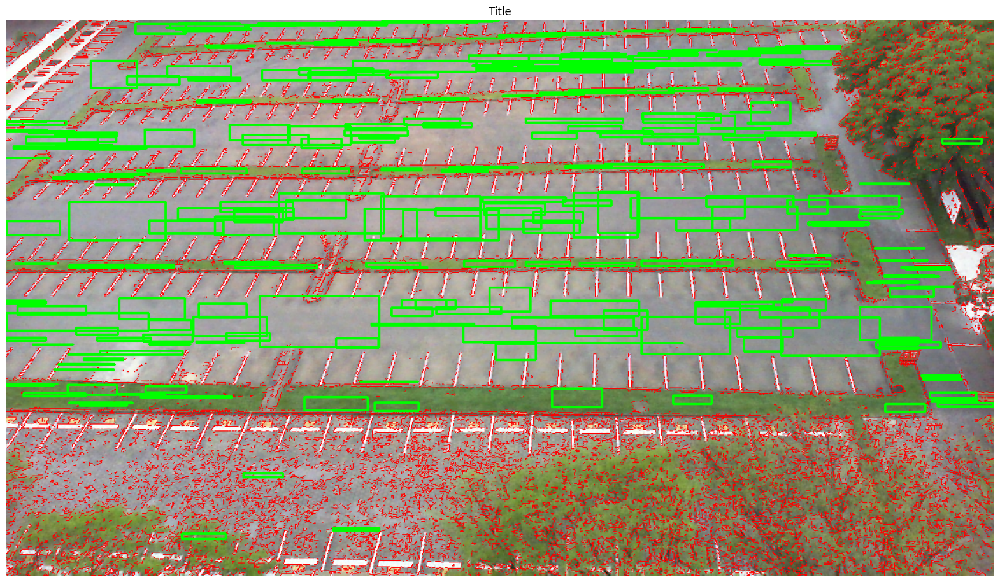

In [619]:
def make_rectangular_boxes(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply GaussianBlur to reduce noise and help the contour detection
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Perform edge detection using Canny
    edges = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    
    # Use HoughLinesP to detect straight lines in the edges
    lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=50, minLineLength=50, maxLineGap=0.05)

    # Convert lines to rectangles
    rectangles = []
    for line in lines:
        x1, y1, x2, y2 = line[0]
        rectangles.append((x1, y1, x2, y2))

    # Apply non-maximum suppression to remove overlapping rectangles
    rectangles = non_max_suppression(rectangles, overlapThresh=0.3)

    # Draw the remaining rectangles on the image
    result_image = image.copy()
    for rect in rectangles:
        x1, y1, x2, y2 = rect
        cv2.rectangle(result_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

    return result_image


result_image = make_rectangular_boxes(line_images[0])

# Display the result
show_image(result_image)

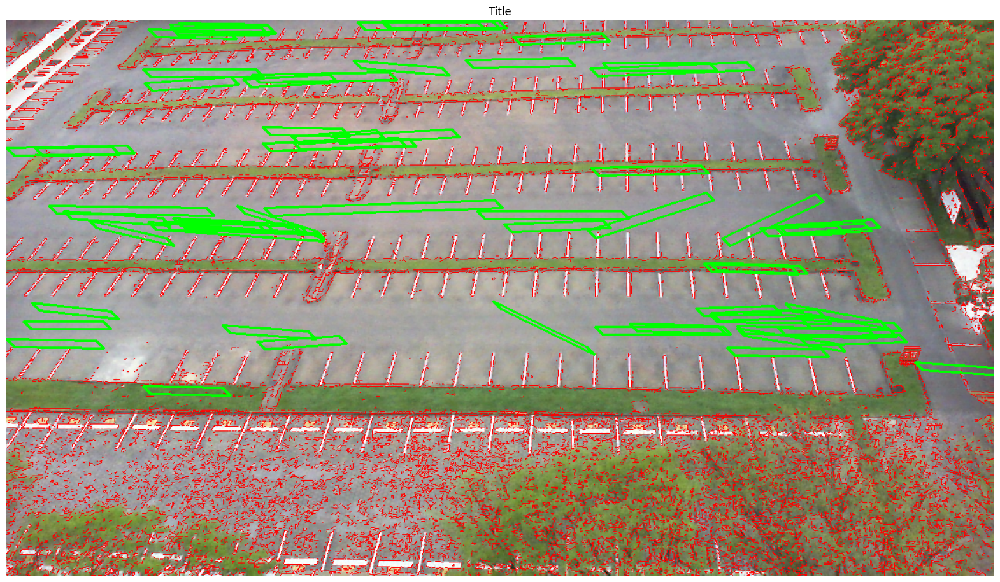

In [620]:

def make_quadrilaterals(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply GaussianBlur to reduce noise and help the contour detection
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Perform edge detection using Canny
    edges = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    # Use HoughLinesP to detect lines in the edges
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=100, minLineLength=100, maxLineGap=0.03)

    # Create quadrilaterals based on the detected lines
    result_image = image.copy()
    for line in lines:
        x1, y1, x2, y2 = line[0]
        
        # Create a quadrilateral (you can customize the shape here)
        pts = np.array([[x1, y1], [x2, y2], [x2+10, y2+10], [x1+10, y1+10]], np.int32)
        pts = pts.reshape((-1, 1, 2))

        # Draw the quadrilateral on the image
        cv2.polylines(result_image, [pts], isClosed=True, color=(0, 255, 0), thickness=2)

    return result_image

#white_yellow_image = select_rgb_white_yellow(img_rgb)
result_image = make_quadrilaterals(line_images[0])

# Display the result
show_image(result_image)

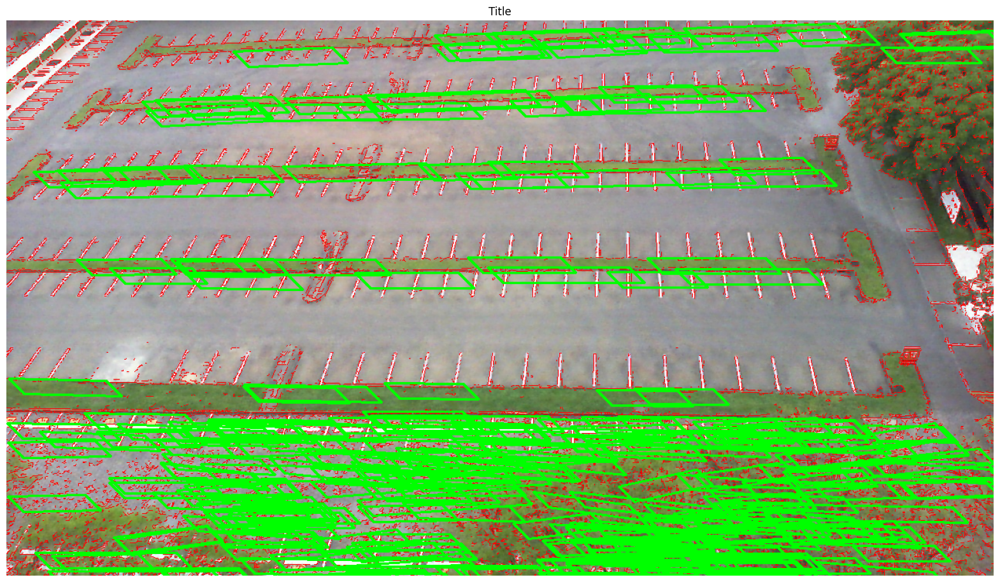

In [621]:
def make_irregular_quadrilaterals(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply GaussianBlur to reduce noise and help the contour detection
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Perform edge detection using Canny
    edges = cv2.Canny(blurred, 50, 150)

    # Use HoughLinesP to detect lines in the edges
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=100, minLineLength=100, maxLineGap=10)

    # Create irregular quadrilaterals based on the detected lines
    result_image = image.copy()
    for line in lines:
        x1, y1, x2, y2 = line[0]
        
        # Create a quadrilateral by adding some random perturbation to the line endpoints
        perturbation = 20
        vertices = np.array([[x1, y1], [x2, y2], [x2 + perturbation, y2 + perturbation], [x1 + perturbation, y1 + perturbation]])
        vertices = vertices.reshape((-1, 1, 2))

        # Draw the quadrilateral
        cv2.polylines(result_image, [vertices], isClosed=True, color=(0, 255, 0), thickness=2)

    return result_image


result_image = make_irregular_quadrilaterals(line_images[0])

# Display the result
show_image(result_image)
